In [1]:
# Add project root so we can import spine_score.src modules
# may need to rename spine-score folder to "spine_score"
import sys
from pathlib import Path
sys.path.append(str(Path().resolve().parent))

# External libraries
import importlib
from pathlib import Path
import os
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
import glob
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch import amp
from tqdm import tqdm
import numpy as np

# Internal modules
from spine_score.src import extract, dataset, model
from spine_score.src.model import SimpleUNet3D

In [2]:
# Reloads modules (run for development update with the notebook)
importlib.reload(extract) 
importlib.reload(dataset)
importlib.reload(model)

<module 'spine_score.src.model' from 'C:\\Users\\Maxtw\\OneDrive\\Desktop\\Final Project 521\\aai-521-final-project\\spine_score\\src\\model.py'>

In [3]:
# # Matching Study Ids to ensure that segmentation and images are mapped appropriately

# # DICOM root after structural extraction
# dicom_root = "../data/interim/imaging_files/case_image"

# # Segmentation mask root
# mask_root = "../data/interim/segmentation"

# # Map study_id -> DICOM folder
# dicom_map = {}
# for folder in glob.glob(os.path.join(dicom_root, "*")):  # first level
#     study_id = os.path.basename(folder)

#     # pick the deepest folder containing DICOMs
#     dcm_subfolders = [
#         f for f in glob.glob(os.path.join(folder, "**"), recursive=True) 
#         if os.path.isdir(f) and len(glob.glob(os.path.join(f, "*.dcm"))) > 0
#     ]
#     if dcm_subfolders:
#         dicom_map[study_id] = dcm_subfolders[0]
        
# # Map study_id -> segmentation file mapping
# mask_map = {}
# for mask_file in glob.glob(os.path.join(mask_root, "*_SEG.nii.gz")):
#     study_id = os.path.basename(mask_file).split("_")[0]
#     mask_map[study_id] = mask_file

# # Only keep the studies that have both DICOMs and masks
# dataset_entries = [(dicom_map[s], mask_map[s]) for s in dicom_map if s in mask_map]

# print(f"Found {len(dataset_entries)} paired DICOMs and masks")
# print(f"Example entry: {dataset_entries[0]}")

In [4]:
import os, glob, re
import pydicom
from collections import defaultdict

# -------------------------------
# 1. Paths
# -------------------------------
dicom_root = "../data/interim/imaging_files/case_image"
mask_root  = "../data/interim/segmentation"

# -------------------------------
# 2. Build DICOM metadata map
# -------------------------------
dicom_meta = defaultdict(list)

print("Scanning DICOM folders...\n")

for patient_folder in glob.glob(os.path.join(dicom_root, "*")):
    patient_id = os.path.basename(patient_folder)

    # All folders containing *.dcm files
    series_dirs = [
        d for d in glob.glob(os.path.join(patient_folder, "**"), recursive=True)
        if os.path.isdir(d) and len(glob.glob(os.path.join(d, "*.dcm"))) > 0
    ]

    for sd in series_dirs:
        example_file = glob.glob(os.path.join(sd, "*.dcm"))[0]

        try:
            ds = pydicom.dcmread(example_file, stop_before_pixels=True)

            dicom_meta[patient_id].append({
                "folder": sd,
                "SeriesInstanceUID": getattr(ds, "SeriesInstanceUID", None),
                "SeriesNumber":     getattr(ds, "SeriesNumber", None),
                "StudyInstanceUID": getattr(ds, "StudyInstanceUID", None),
            })
        except Exception as e:
            print(f"Failed reading {example_file}: {e}")

# -------------------------------
# 3. Build Mask metadata map
# -------------------------------
mask_meta = defaultdict(list)

print("\nScanning mask files...\n")

mask_pattern = re.compile(
    r"(\d+-\d+)_Study-[A-Za-z]+-(\d+)_Series-(\d+)_SEG\.nii\.gz"
)

for mask_file in glob.glob(os.path.join(mask_root, "*.nii.gz")):
    base = os.path.basename(mask_file)

    m = mask_pattern.match(base)
    if m:
        pid, study_num, series_num = m.groups()

        mask_meta[pid].append({
            "file": mask_file,
            "StudyNumber": int(study_num),
            "SeriesNumber": int(series_num)
        })
    else:
        print(f"Could not parse mask name: {mask_file}")

# -------------------------------
# 4. Match masks ↔ DICOM series
# -------------------------------
dataset_entries = []

print("\nMatching masks to DICOM series...\n")

for pid in mask_meta:
    print(f"Patient {pid}:")
    dcm_list = dicom_meta.get(pid, [])

    for mask in mask_meta[pid]:
        target_series = mask["SeriesNumber"]

        match = None
        for dcm in dcm_list:
            if dcm["SeriesNumber"] == target_series:
                match = dcm
                break

        if match:
            dataset_entries.append((pid, match["folder"], mask["file"]))
            print(f"  MATCH: Series {target_series} →")
            print(f"      Image: {match['folder']}")
            print(f"      Mask:  {mask['file']}")
        else:
            print(f"  NO MATCH FOR mask: {mask['file']} (Series {target_series})")

# -------------------------------
# 5. Summary
# -------------------------------
print("\n====================")
print("SUMMARY")
print("====================")
print(f"Total matched pairs: {len(dataset_entries)}\n")

if len(dataset_entries) > 0:
    print("Example pair:")
    print(dataset_entries[0])


Scanning DICOM folders...


Scanning mask files...


Matching masks to DICOM series...

Patient 593973-000001:
  MATCH: Series 22 →
      Image: ../data/interim/imaging_files/case_image\593973-000001\1.2.826.0.1.3680043.10.474.593973.2\1.2.826.0.1.3680043.10.474.593973.3
      Mask:  ../data/interim/segmentation\593973-000001_Study-MR-1_Series-22_SEG.nii.gz
Patient 593973-000002:
  MATCH: Series 3 →
      Image: ../data/interim/imaging_files/case_image\593973-000002\1.2.826.0.1.3680043.10.474.593973.19\1.2.826.0.1.3680043.10.474.593973.20
      Mask:  ../data/interim/segmentation\593973-000002_Study-MR-2_Series-3_SEG.nii.gz
Patient 593973-000003:
  MATCH: Series 3 →
      Image: ../data/interim/imaging_files/case_image\593973-000003\1.2.826.0.1.3680043.10.474.593973.36\1.2.826.0.1.3680043.10.474.593973.37
      Mask:  ../data/interim/segmentation\593973-000003_Study-MR-3_Series-3_SEG.nii.gz
Patient 593973-000004:
  MATCH: Series 3 →
      Image: ../data/interim/imaging_files/case_image

In [5]:
from sklearn.model_selection import train_test_split

# dataset_entries already built earlier
print("Total samples:", len(dataset_entries))
print(dataset_entries)

# Split percentages: 70% train, 15% test, 15% val
train_entries, temp_entries = train_test_split(
    dataset_entries, test_size=0.3, random_state=42
)

val_entries, test_entries = train_test_split(
    temp_entries, test_size=0.5, random_state=42
)

print(f"Train 70%: {len(train_entries)}")
print(f"Val 15%:   {len(val_entries)}")
print(f"Test 15%:  {len(test_entries)}")


Total samples: 1255
[('593973-000001', '../data/interim/imaging_files/case_image\\593973-000001\\1.2.826.0.1.3680043.10.474.593973.2\\1.2.826.0.1.3680043.10.474.593973.3', '../data/interim/segmentation\\593973-000001_Study-MR-1_Series-22_SEG.nii.gz'), ('593973-000002', '../data/interim/imaging_files/case_image\\593973-000002\\1.2.826.0.1.3680043.10.474.593973.19\\1.2.826.0.1.3680043.10.474.593973.20', '../data/interim/segmentation\\593973-000002_Study-MR-2_Series-3_SEG.nii.gz'), ('593973-000003', '../data/interim/imaging_files/case_image\\593973-000003\\1.2.826.0.1.3680043.10.474.593973.36\\1.2.826.0.1.3680043.10.474.593973.37', '../data/interim/segmentation\\593973-000003_Study-MR-3_Series-3_SEG.nii.gz'), ('593973-000004', '../data/interim/imaging_files/case_image\\593973-000004\\1.2.826.0.1.3680043.10.474.593973.53\\1.2.826.0.1.3680043.10.474.593973.54', '../data/interim/segmentation\\593973-000004_Study-MR-4_Series-3_SEG.nii.gz'), ('593973-000005', '../data/interim/imaging_files/cas

In [6]:
# Create dataset + dataloaders
target_shape = (1, 224, 224, 48)  # divisible by 16 (if UNet has 4 downsamplings)
target_spacing=(1.0, 1.0, 1.0)

# Creating a dataset objects that knows how to load DICOM volumes + NIfTI masks one sample at a time
train_dataset = dataset.SpineSegDataset(train_entries, target_shape=target_shape, target_spacing=target_spacing)
val_dataset   = dataset.SpineSegDataset(val_entries, target_shape=target_shape, target_spacing=target_spacing)
test_dataset  = dataset.SpineSegDataset(test_entries, target_shape=target_shape, target_spacing=target_spacing)

# Wraps dataset into an iterable loader that handles batching + shuffling
# You may need to edit these values to efficiently train on your system (especially batch_size)
train_loader = DataLoader(train_dataset, batch_size=2, shuffle=True,
                          num_workers=8, pin_memory=True, persistent_workers=True)
val_loader   = DataLoader(val_dataset,   batch_size=2, shuffle=False,
                          num_workers=4, pin_memory=True, persistent_workers=True)
test_loader  = DataLoader(test_dataset,  batch_size=2, shuffle=False,
                          num_workers=4, pin_memory=True, persistent_workers=True)

Volume shape: torch.Size([2, 1, 224, 224, 48])
Mask shape: torch.Size([2, 224, 224, 48])


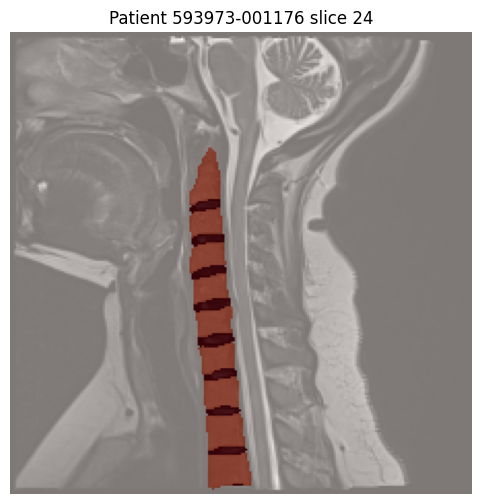

In [7]:
# Preview one batch to ensure correct tensor shapes
vol, msk, patient_id = next(iter(train_loader))

print("Volume shape:", vol.shape)       # should be (batch, 1, H, W, D)
print("Mask shape:", msk.shape)         # should be (batch, H, W, D)

# Visualize a middle slice for the first patient in the batch
mid = msk.shape[-1] // 2
plt.figure(figsize=(6,6))
plt.imshow(vol[0,0,:,:,mid].cpu(), cmap="gray")
plt.imshow(msk[0,:,:,mid].cpu(), cmap="Reds", alpha=0.5)
plt.axis("off")
plt.title(f"Patient {patient_id[0]} slice {mid}")
plt.show()


Volume shape: torch.Size([2, 1, 224, 224, 48])
Mask shape:   torch.Size([2, 224, 224, 48])


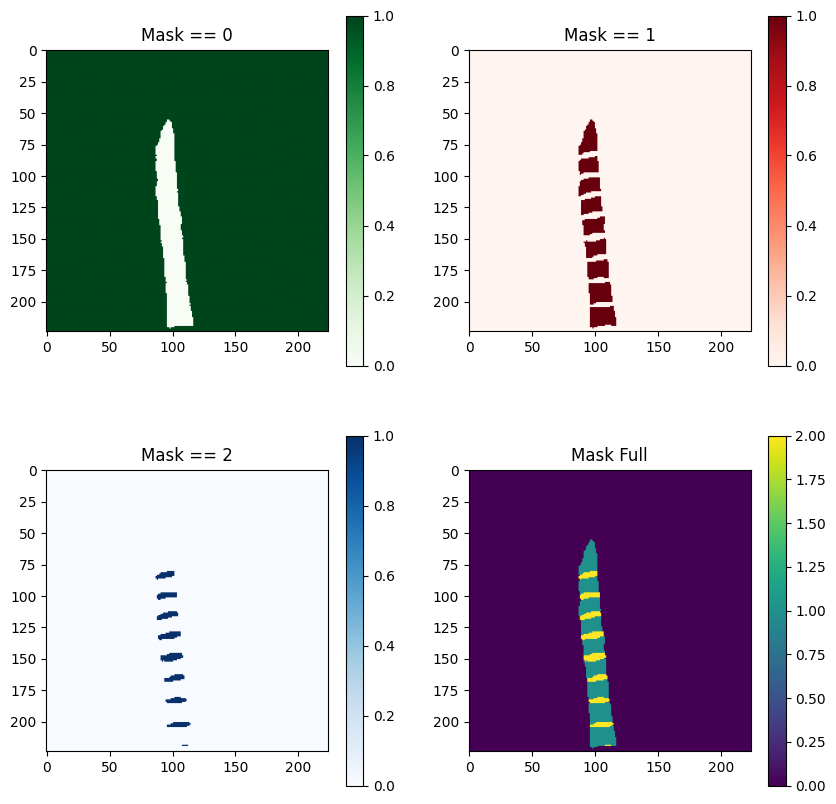

In [8]:
# Inspect mask classes visually for the first sample

# vol, msk, patient_id = next(iter(train_loader)) # (obtained from previous cell)
print("Volume shape:", vol.shape)
print("Mask shape:  ", msk.shape)

# msk shape: (1, H, W, D)
mid = msk.shape[-1] // 2   # mid slice along depth

plt.figure(figsize=(10,10))

# Class 0
plt.subplot(2,2,1)
plt.title("Mask == 0")
plt.imshow((msk[0,:,:,mid] == 0).cpu(), cmap="Greens")
plt.colorbar()

# Class 1
plt.subplot(2,2,2)
plt.title("Mask == 1")
plt.imshow((msk[0,:,: ,mid] == 1).cpu(), cmap="Reds")
plt.colorbar()

# Class 2
plt.subplot(2,2,3)
plt.title("Mask == 2")
plt.imshow((msk[0,:,: ,mid] == 2).cpu(), cmap="Blues")
plt.colorbar()

# Complete mask
plt.subplot(2,2,4)
plt.title("Mask Full")
plt.imshow(msk[0,:,:,mid].cpu(), cmap="viridis")
plt.colorbar()

plt.show()


In [9]:
# Print shapes from all splites to verify consistency

train_batch = next(iter(train_loader))
val_batch = next(iter(val_loader))
test_batch = next(iter(test_loader))

print(f"Train sample shapes: \nVolume: {train_batch[0].shape}, Mask: {train_batch[1].shape}")
print(f"Val sample shapes: \nVolume: {val_batch[0].shape}, Mask: {val_batch[1].shape}")
print(f"Test sample shapes: \nVolume: {test_batch[0].shape}, Mask: {test_batch[1].shape}")

# Unique labels in mask
print("Unique mask labels:", torch.unique(test_batch[1]))


Train sample shapes: 
Volume: torch.Size([2, 1, 224, 224, 48]), Mask: torch.Size([2, 224, 224, 48])
Val sample shapes: 
Volume: torch.Size([2, 1, 224, 224, 48]), Mask: torch.Size([2, 224, 224, 48])
Test sample shapes: 
Volume: torch.Size([2, 1, 224, 224, 48]), Mask: torch.Size([2, 224, 224, 48])
Unique mask labels: tensor([0, 1, 2])


cuda


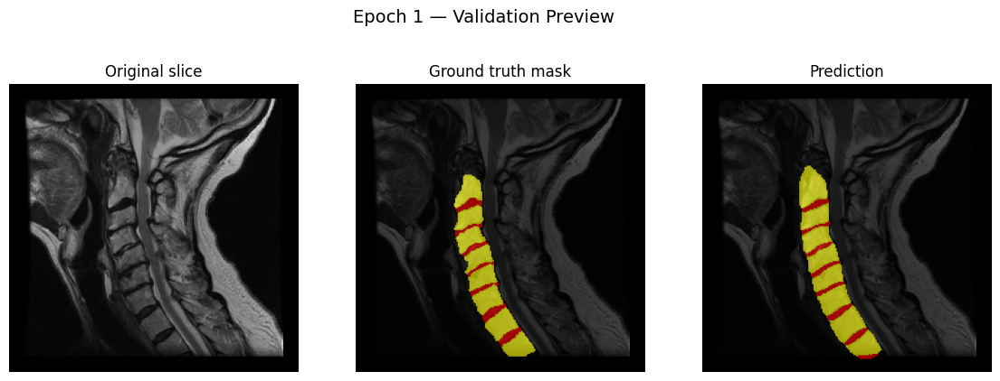

Epoch [1/20] Loss=0.0376 CE=0.0376 DiceLoss=0.9759 ValDice=0.7874 (dice_w=0.000)
🔥 Saved new best model → ../weights\UNet_0.1-1.0-1.0\UNet_0.1-1.0-1.0.pth


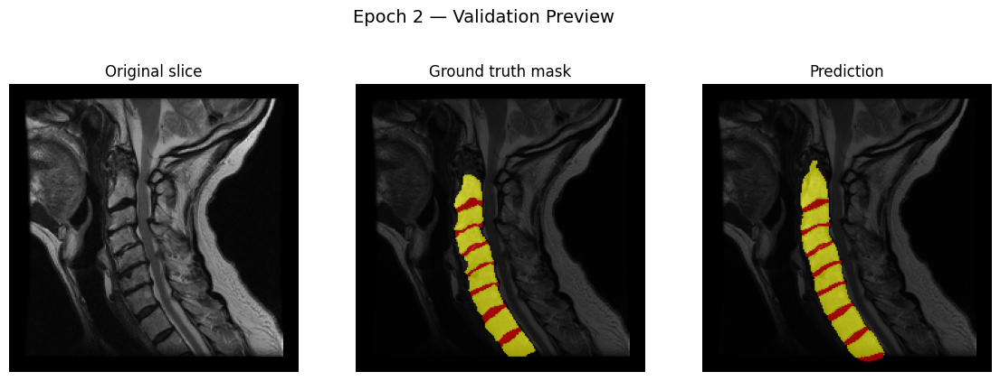

Epoch [2/20] Loss=0.0188 CE=0.0188 DiceLoss=0.9633 ValDice=0.8074 (dice_w=0.000)
🔥 Saved new best model → ../weights\UNet_0.1-1.0-1.0\UNet_0.1-1.0-1.0.pth


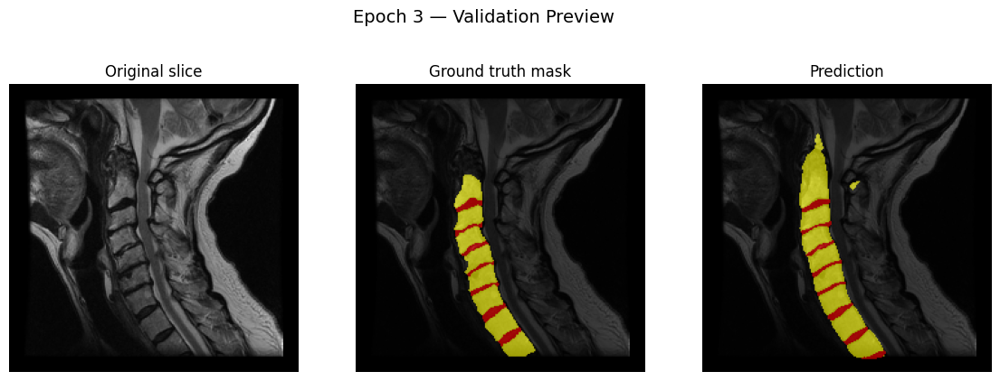

Epoch [3/20] Loss=0.0121 CE=0.0121 DiceLoss=0.9512 ValDice=0.8029 (dice_w=0.000)


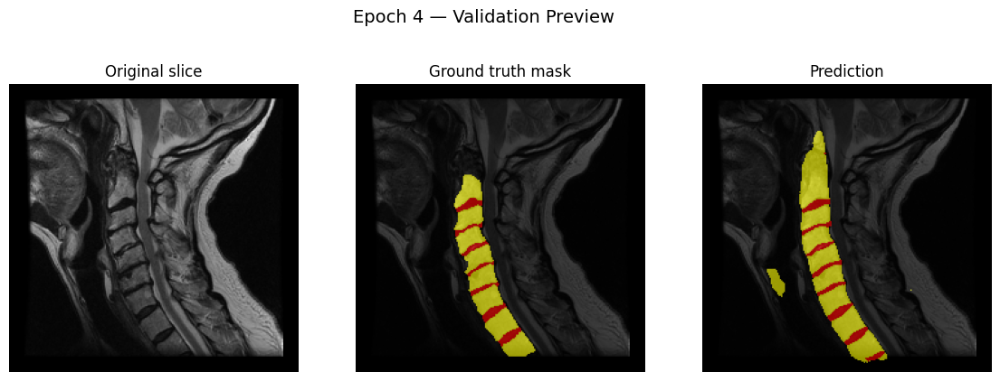

Epoch [4/20] Loss=0.0085 CE=0.0085 DiceLoss=0.9371 ValDice=0.7923 (dice_w=0.000)


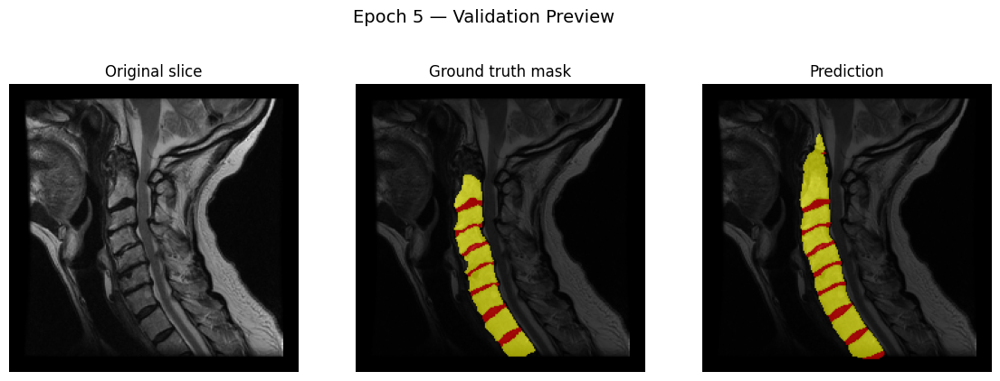

Epoch [5/20] Loss=0.0066 CE=0.0066 DiceLoss=0.9222 ValDice=0.8395 (dice_w=0.000)
🔥 Saved new best model → ../weights\UNet_0.1-1.0-1.0\UNet_0.1-1.0-1.0.pth


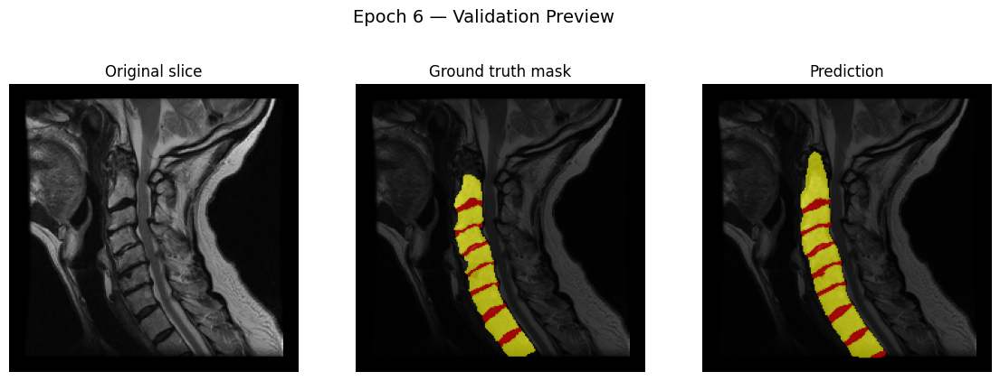

Epoch [6/20] Loss=0.0055 CE=0.0055 DiceLoss=0.9065 ValDice=0.8408 (dice_w=0.000)
🔥 Saved new best model → ../weights\UNet_0.1-1.0-1.0\UNet_0.1-1.0-1.0.pth


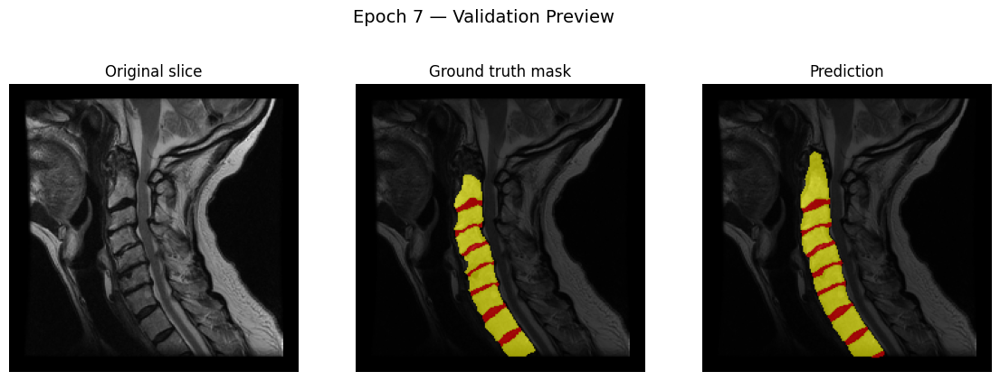

Epoch [7/20] Loss=0.0049 CE=0.0049 DiceLoss=0.8903 ValDice=0.8506 (dice_w=0.000)
🔥 Saved new best model → ../weights\UNet_0.1-1.0-1.0\UNet_0.1-1.0-1.0.pth


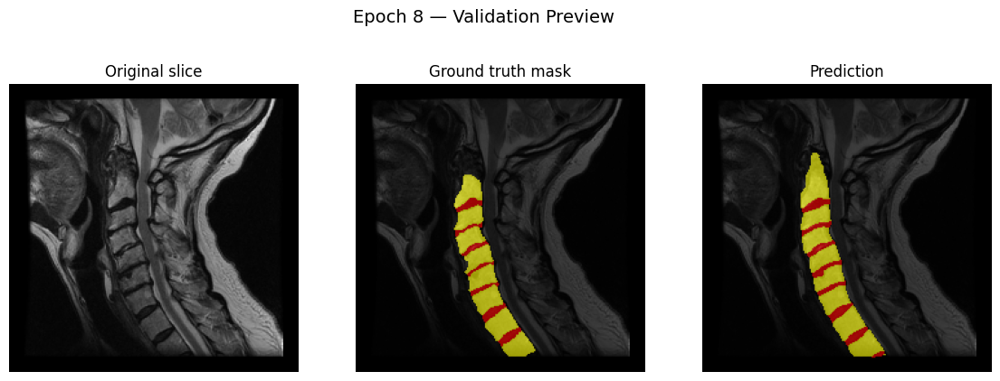

Epoch [8/20] Loss=0.0043 CE=0.0043 DiceLoss=0.8729 ValDice=0.8526 (dice_w=0.000)
🔥 Saved new best model → ../weights\UNet_0.1-1.0-1.0\UNet_0.1-1.0-1.0.pth


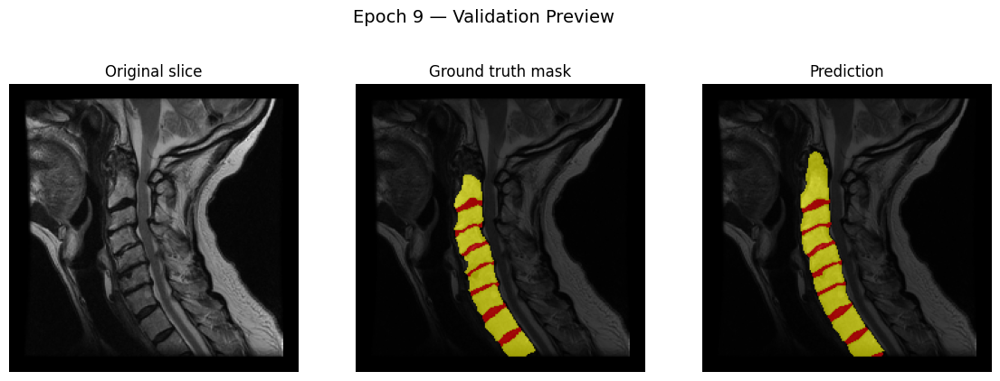

Epoch [9/20] Loss=0.0039 CE=0.0039 DiceLoss=0.8549 ValDice=0.8480 (dice_w=0.000)


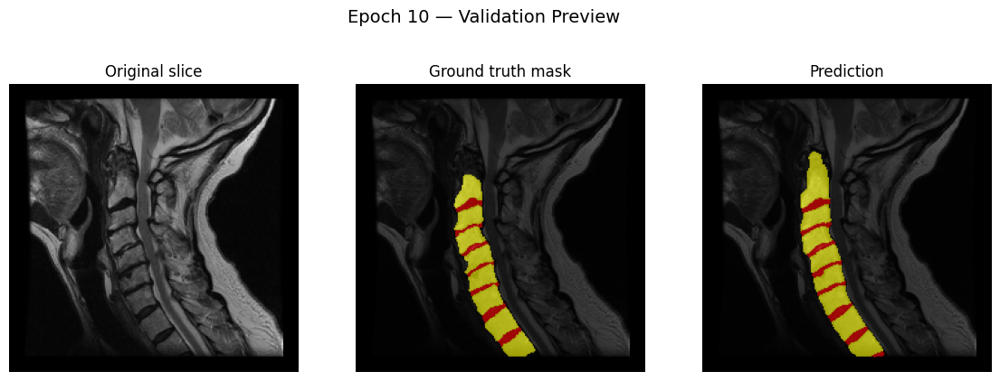

Epoch [10/20] Loss=0.0035 CE=0.0035 DiceLoss=0.8347 ValDice=0.8513 (dice_w=0.000)


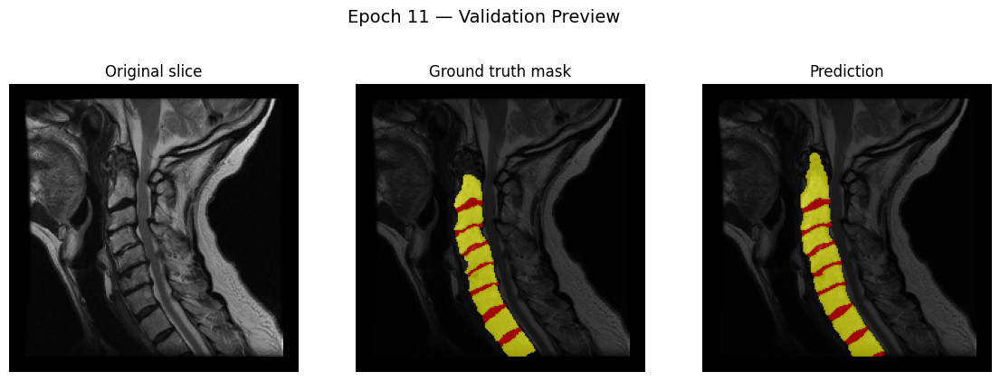

Epoch [11/20] Loss=0.0033 CE=0.0033 DiceLoss=0.8165 ValDice=0.8570 (dice_w=0.000)
🔥 Saved new best model → ../weights\UNet_0.1-1.0-1.0\UNet_0.1-1.0-1.0.pth


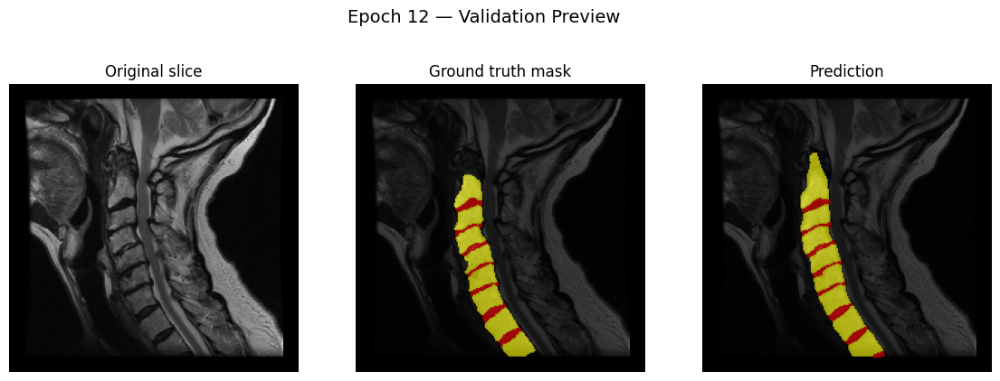

Epoch [12/20] Loss=0.0032 CE=0.0032 DiceLoss=0.7972 ValDice=0.8594 (dice_w=0.000)
🔥 Saved new best model → ../weights\UNet_0.1-1.0-1.0\UNet_0.1-1.0-1.0.pth


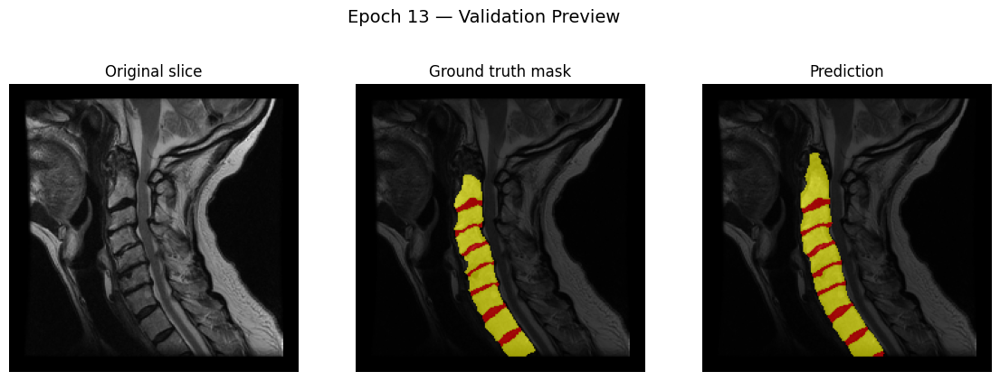

Epoch [13/20] Loss=0.0030 CE=0.0030 DiceLoss=0.7761 ValDice=0.8550 (dice_w=0.000)


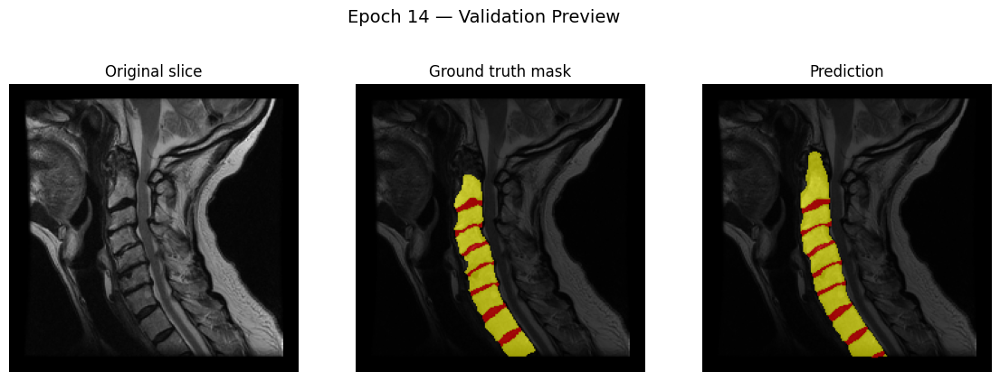

Epoch [14/20] Loss=0.0028 CE=0.0028 DiceLoss=0.7555 ValDice=0.8529 (dice_w=0.000)


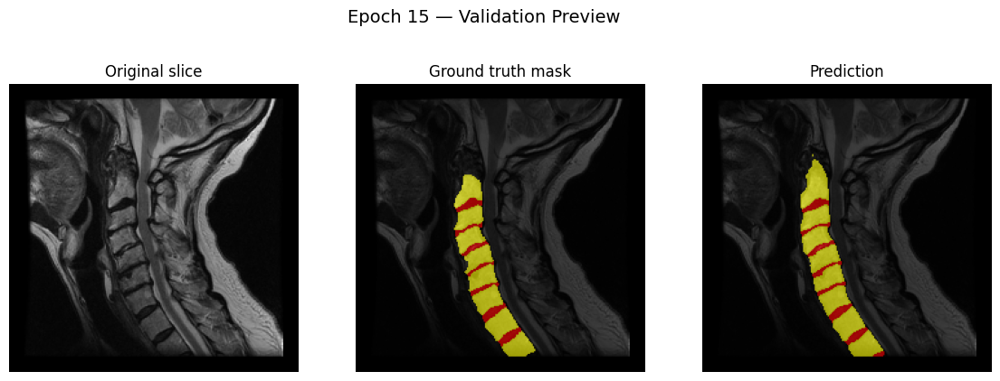

Epoch [15/20] Loss=0.0027 CE=0.0027 DiceLoss=0.7343 ValDice=0.8676 (dice_w=0.000)
🔥 Saved new best model → ../weights\UNet_0.1-1.0-1.0\UNet_0.1-1.0-1.0.pth


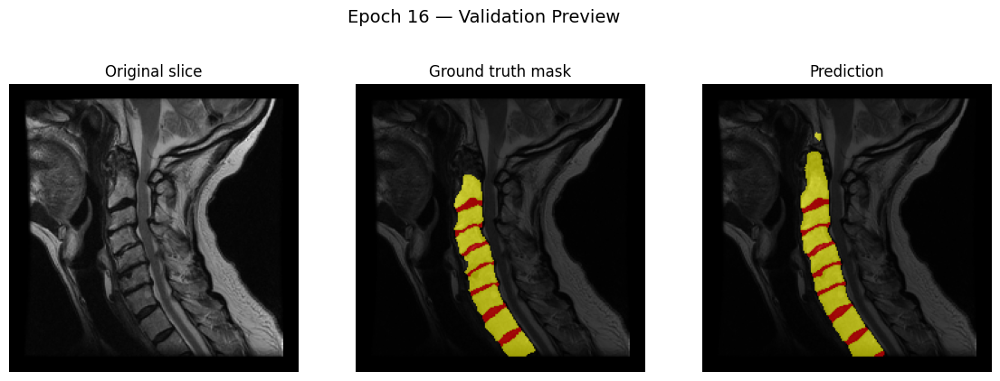

Epoch [16/20] Loss=0.0028 CE=0.0028 DiceLoss=0.7168 ValDice=0.8415 (dice_w=0.000)


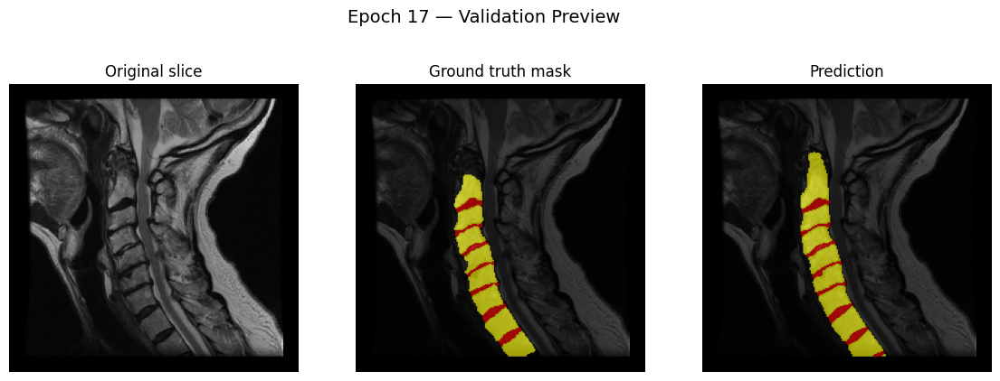

Epoch [17/20] Loss=0.0026 CE=0.0026 DiceLoss=0.6944 ValDice=0.8711 (dice_w=0.000)
🔥 Saved new best model → ../weights\UNet_0.1-1.0-1.0\UNet_0.1-1.0-1.0.pth


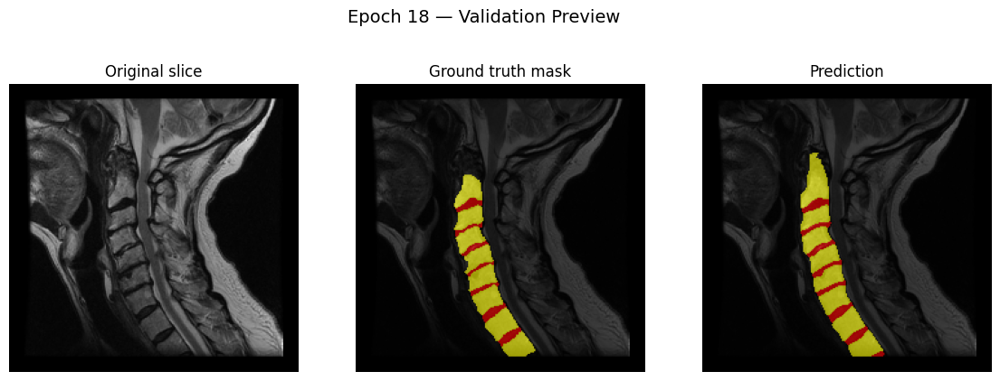

Epoch [18/20] Loss=0.0024 CE=0.0024 DiceLoss=0.6670 ValDice=0.8677 (dice_w=0.000)


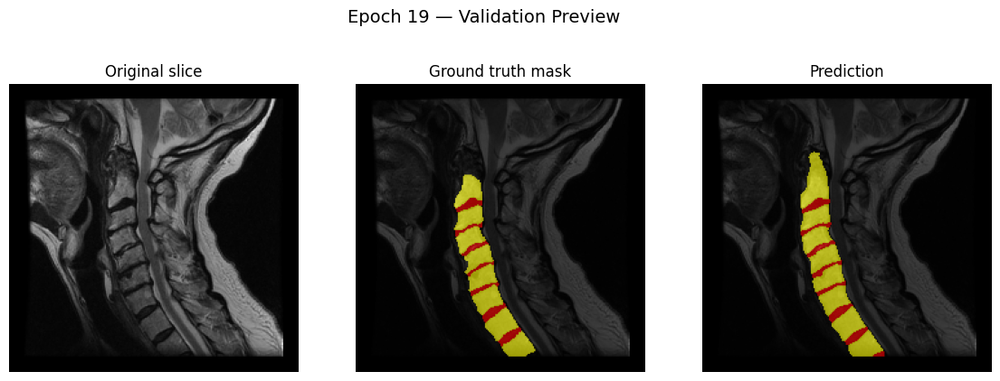

Epoch [19/20] Loss=0.0023 CE=0.0023 DiceLoss=0.6460 ValDice=0.8732 (dice_w=0.000)
🔥 Saved new best model → ../weights\UNet_0.1-1.0-1.0\UNet_0.1-1.0-1.0.pth


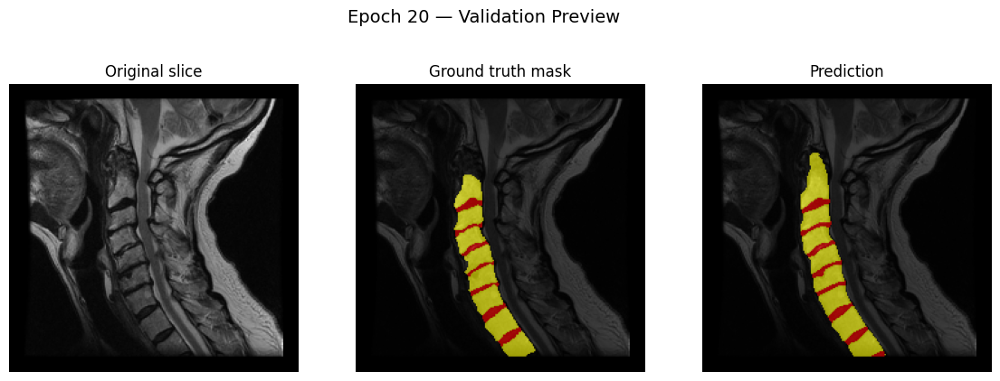

Epoch [20/20] Loss=0.0022 CE=0.0022 DiceLoss=0.6245 ValDice=0.8697 (dice_w=0.000)


In [10]:
# Set device + initialize model + train
device = "cuda" if torch.cuda.is_available() else "cpu"
print(device)

model_UNet = SimpleUNet3D(in_channels=1, out_channels=3)

# CE weights are [0.1, 1.0, 2.0] for background, vertebrae, and disks respectively
# Must be changed withing the train_model_UNet function inside model.py
model_UNet, history = model.train_model_UNet(
    model_UNet, 
    train_loader, 
    val_loader, 
    device, 
    save_name="UNet_0.1-1.0-1.0.pth",
    num_epochs=20, 
    lr=5e-5, 
    num_classes=3
)

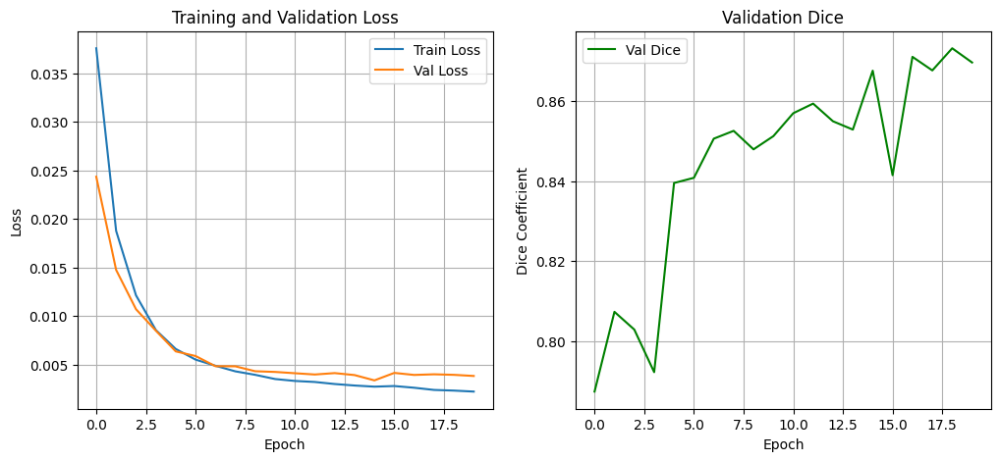

✔️ Saved training curves to ..\weights\UNet_0.1-1.0-1.0\training_curves.png


In [11]:
# --- choose your folder ---
save_name = "UNet_0.1-1.0-1.0"
save_dir = Path("../weights") / save_name
save_dir.mkdir(parents=True, exist_ok=True)

# Plot Training Curves
plt.figure(figsize=(12,5))

# Loss
plt.subplot(1,2,1)
plt.plot(history['train_loss'], label='Train Loss')
plt.plot(history['val_loss'], label='Val Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Training and Validation Loss')
plt.legend()
plt.grid(True)

# Dice
plt.subplot(1,2,2)
plt.plot(history['val_dice'], label='Val Dice', color='green')
plt.xlabel('Epoch')
plt.ylabel('Dice Coefficient')
plt.title('Validation Dice')
plt.legend()
plt.grid(True)

# Save
curve_path = save_dir / "training_curves.png"
plt.savefig(curve_path, dpi=200, bbox_inches="tight")

plt.show()

print(f"✔️ Saved training curves to {curve_path}")



In [12]:
# Save model weights
save_path = "../weights/UNet_0.1-1.0-1.0/UNet_all_epochs_0.1-1.0-1.0.pth"
torch.save(model_UNet.state_dict(), save_path)
print(f"Model saved to {save_path}")

Model saved to ../weights/UNet_0.1-1.0-1.0/UNet_all_epochs_0.1-1.0-1.0.pth


Initializing V-Net on cuda...


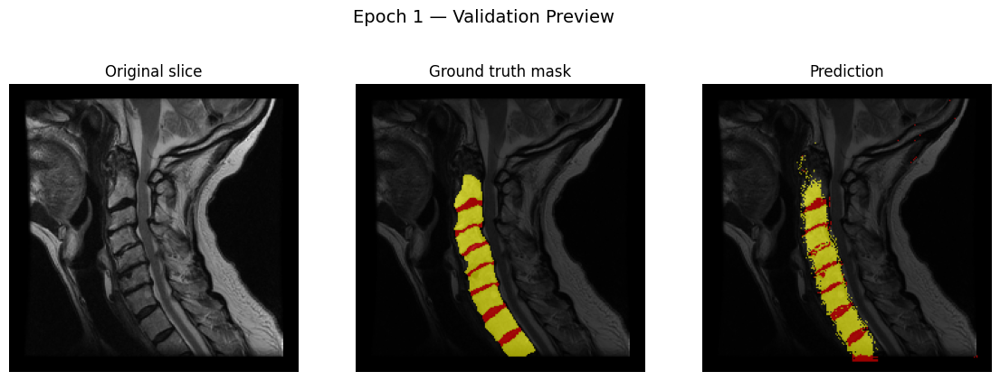

Epoch [1/20] Train Loss: 0.6903 Val Loss: 0.1120 Val Dice: 0.6919
🔥 Saved new best model → ../weights\VNet_Deep_Sup_v1\VNet_Deep_Sup_v1.pth


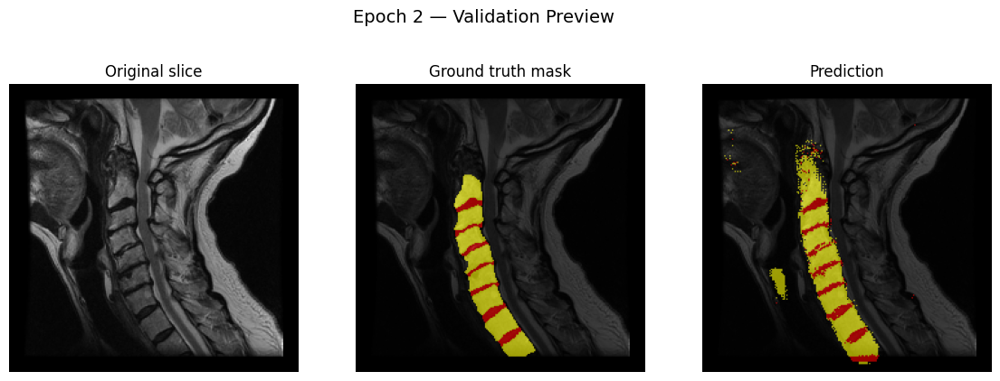

Epoch [2/20] Train Loss: 0.1142 Val Loss: 0.0750 Val Dice: 0.7530
🔥 Saved new best model → ../weights\VNet_Deep_Sup_v1\VNet_Deep_Sup_v1.pth


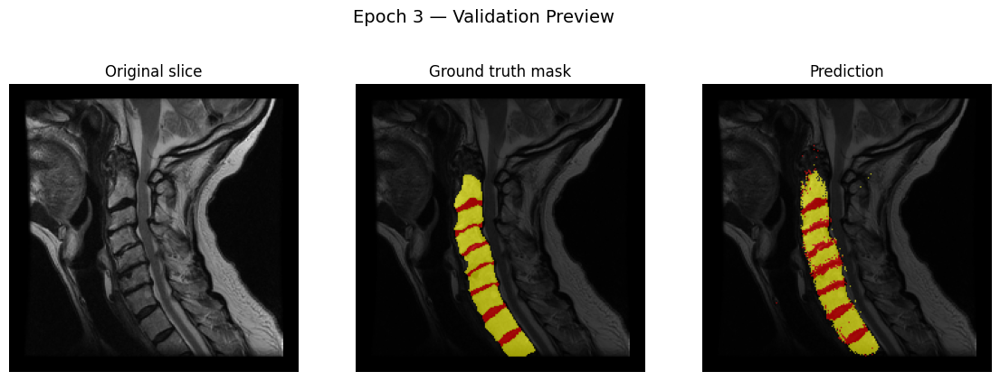

Epoch [3/20] Train Loss: 0.0799 Val Loss: 0.0607 Val Dice: 0.7612
🔥 Saved new best model → ../weights\VNet_Deep_Sup_v1\VNet_Deep_Sup_v1.pth


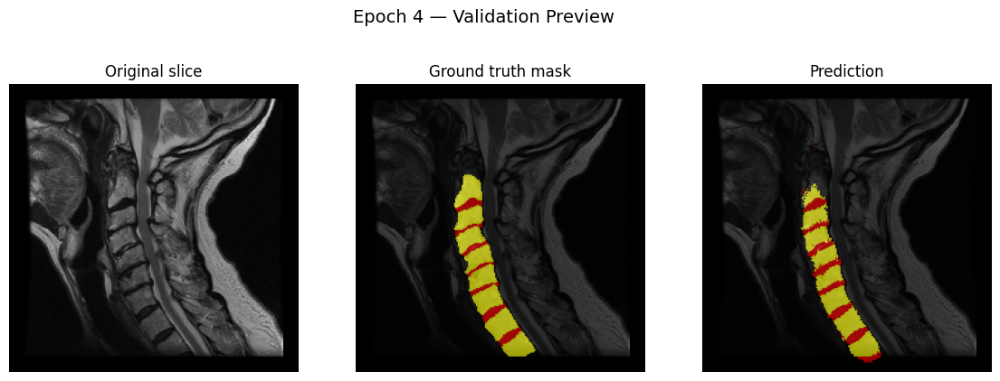

Epoch [4/20] Train Loss: 0.0660 Val Loss: 0.0410 Val Dice: 0.7997
🔥 Saved new best model → ../weights\VNet_Deep_Sup_v1\VNet_Deep_Sup_v1.pth


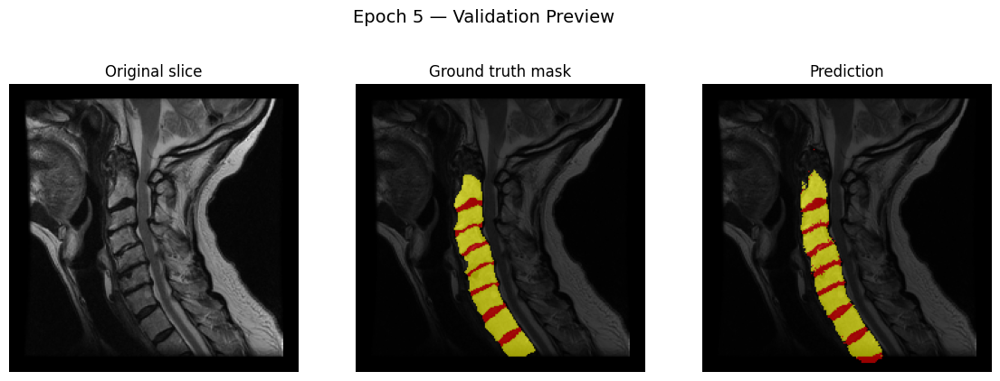

Epoch [5/20] Train Loss: 0.0592 Val Loss: 0.0378 Val Dice: 0.8271
🔥 Saved new best model → ../weights\VNet_Deep_Sup_v1\VNet_Deep_Sup_v1.pth


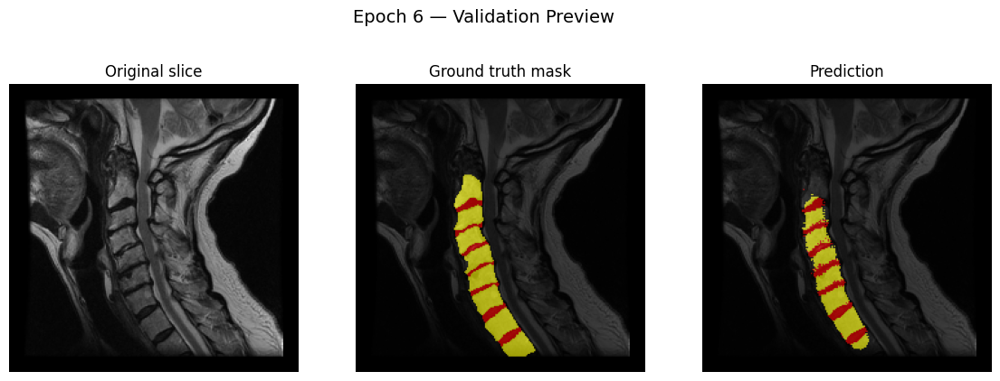

Epoch [6/20] Train Loss: 0.0525 Val Loss: 0.0563 Val Dice: 0.7745


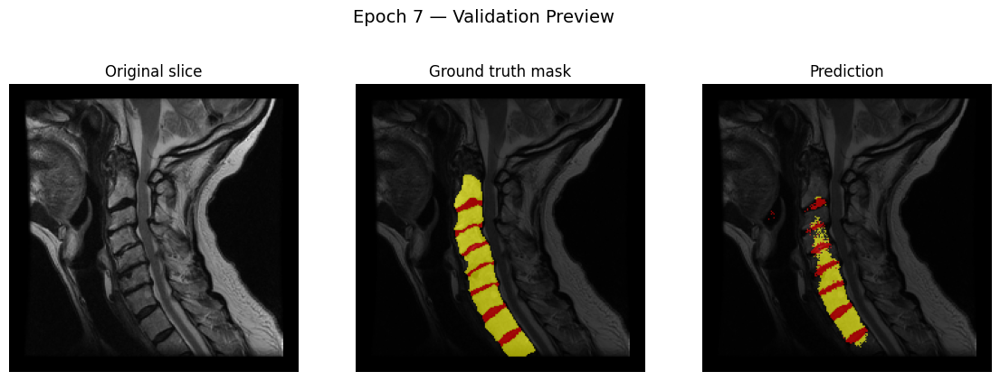

Epoch [7/20] Train Loss: 0.0510 Val Loss: 0.1137 Val Dice: 0.6450


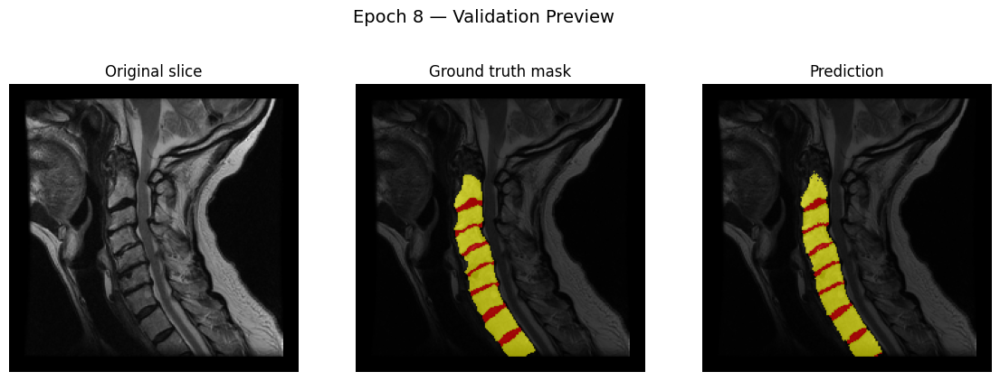

Epoch [8/20] Train Loss: 0.0579 Val Loss: 0.0303 Val Dice: 0.8412
🔥 Saved new best model → ../weights\VNet_Deep_Sup_v1\VNet_Deep_Sup_v1.pth


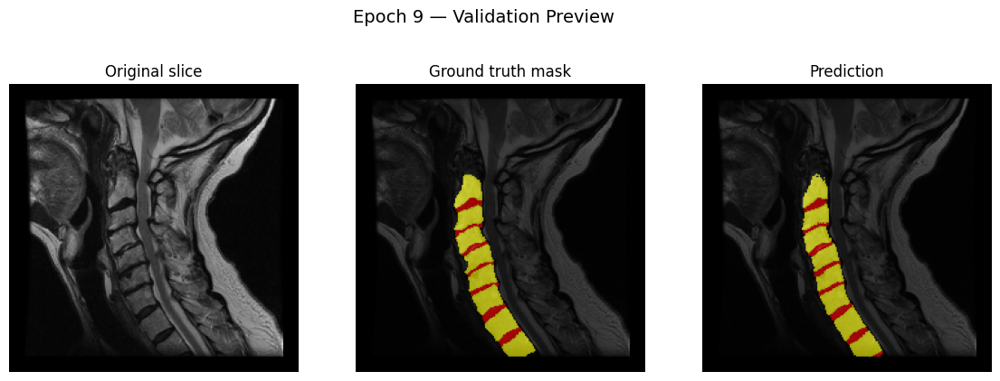

Epoch [9/20] Train Loss: 0.0425 Val Loss: 0.0280 Val Dice: 0.8608
🔥 Saved new best model → ../weights\VNet_Deep_Sup_v1\VNet_Deep_Sup_v1.pth


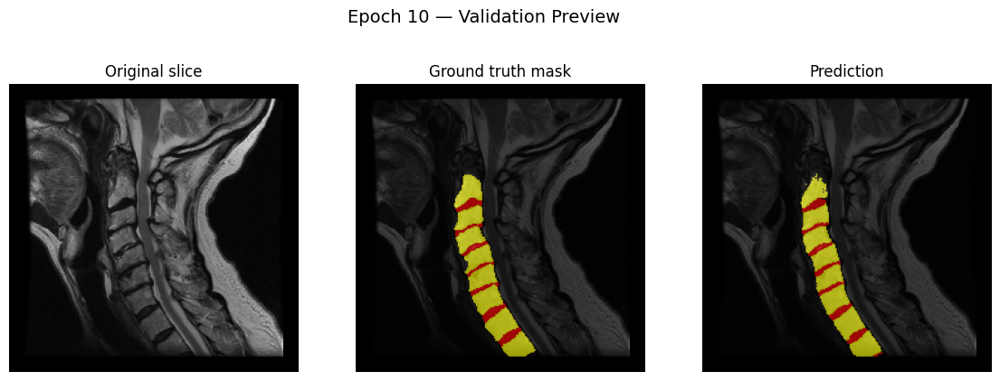

Epoch [10/20] Train Loss: 0.0415 Val Loss: 0.0289 Val Dice: 0.8559


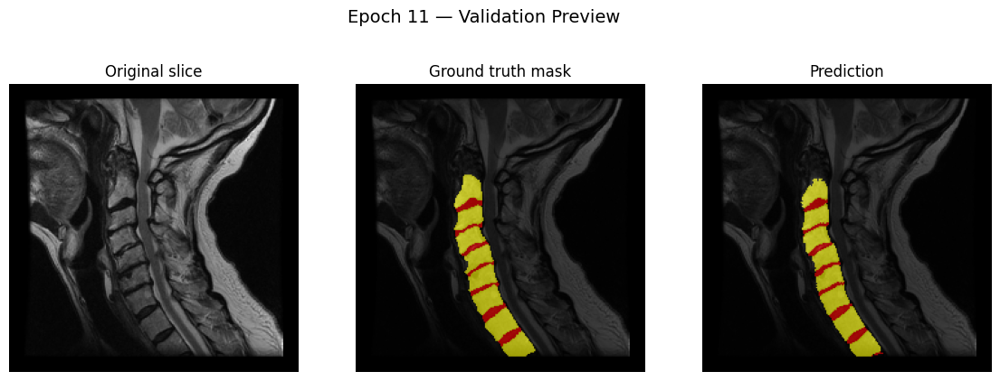

Epoch [11/20] Train Loss: 0.0388 Val Loss: 0.0273 Val Dice: 0.8610
🔥 Saved new best model → ../weights\VNet_Deep_Sup_v1\VNet_Deep_Sup_v1.pth


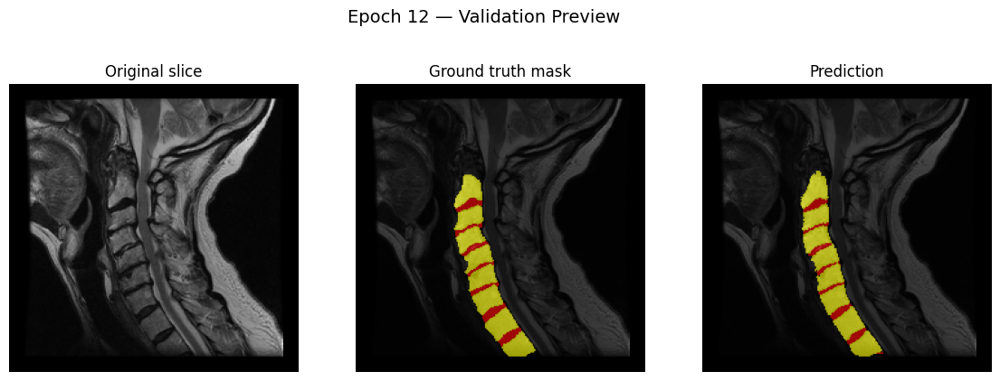

Epoch [12/20] Train Loss: 0.0363 Val Loss: 0.0342 Val Dice: 0.8229


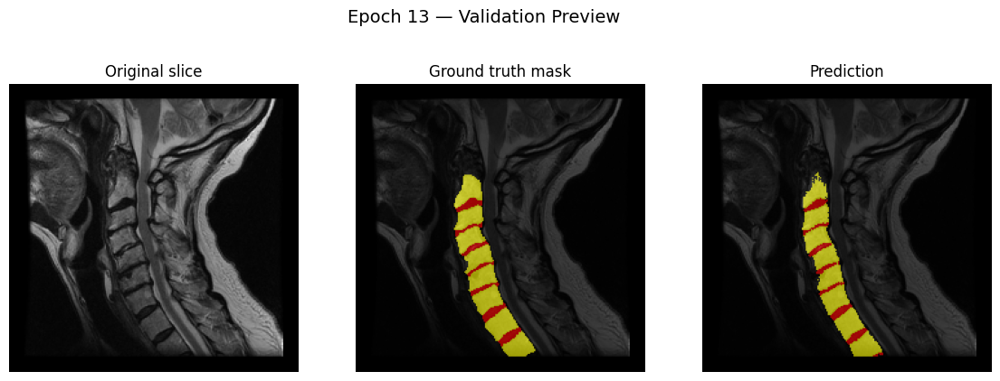

Epoch [13/20] Train Loss: 0.0351 Val Loss: 0.0372 Val Dice: 0.8225


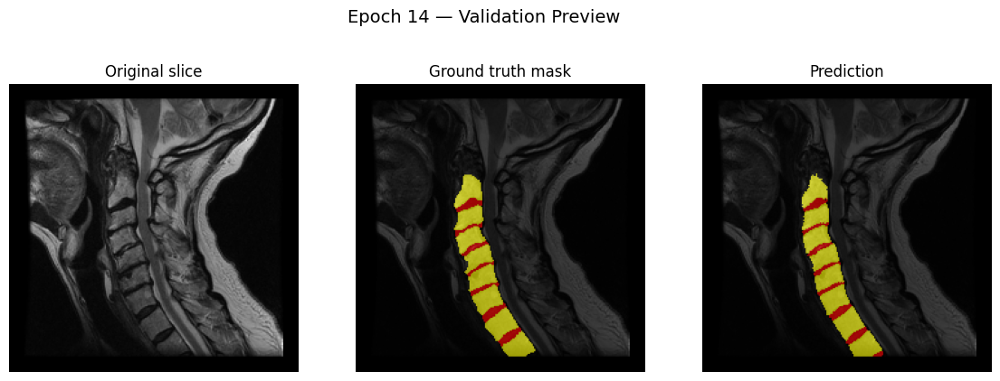

Epoch [14/20] Train Loss: 0.0348 Val Loss: 0.0285 Val Dice: 0.8608


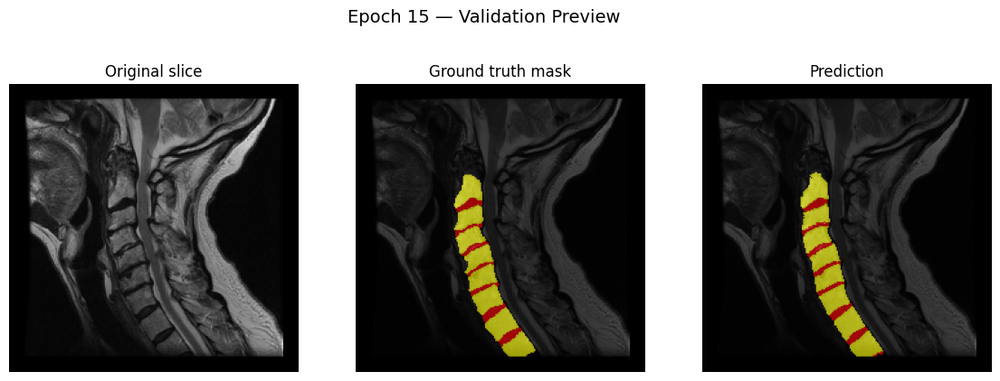

Epoch [15/20] Train Loss: 0.0341 Val Loss: 0.0266 Val Dice: 0.8701
🔥 Saved new best model → ../weights\VNet_Deep_Sup_v1\VNet_Deep_Sup_v1.pth


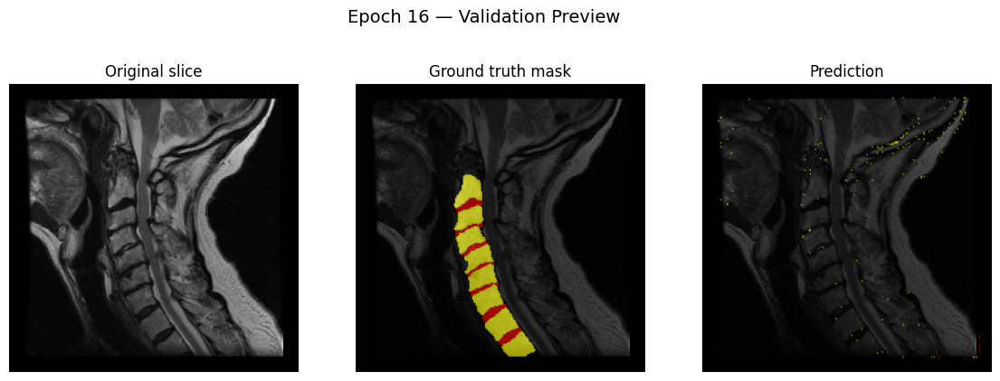

Epoch [16/20] Train Loss: 5.6440 Val Loss: 0.7029 Val Dice: 0.3306


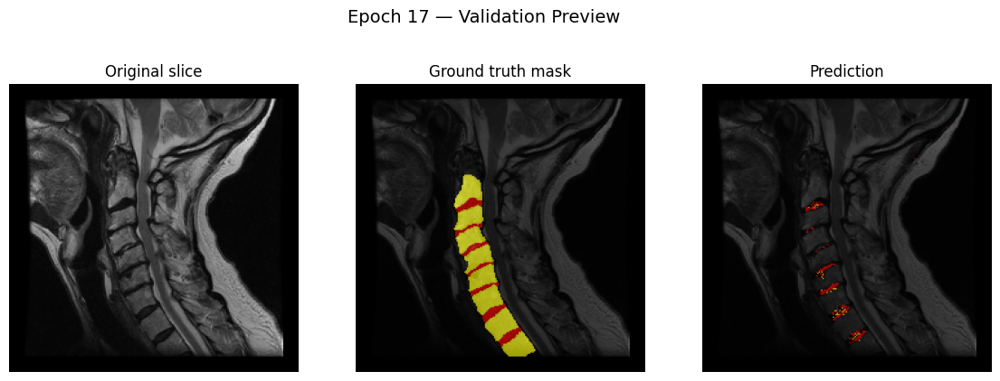

Epoch [17/20] Train Loss: 0.5459 Val Loss: 0.2381 Val Dice: 0.4202


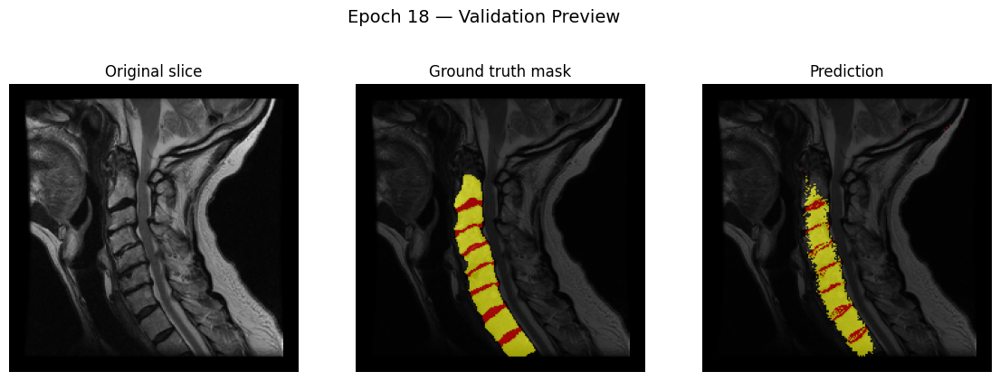

Epoch [18/20] Train Loss: 0.1835 Val Loss: 0.0794 Val Dice: 0.6593


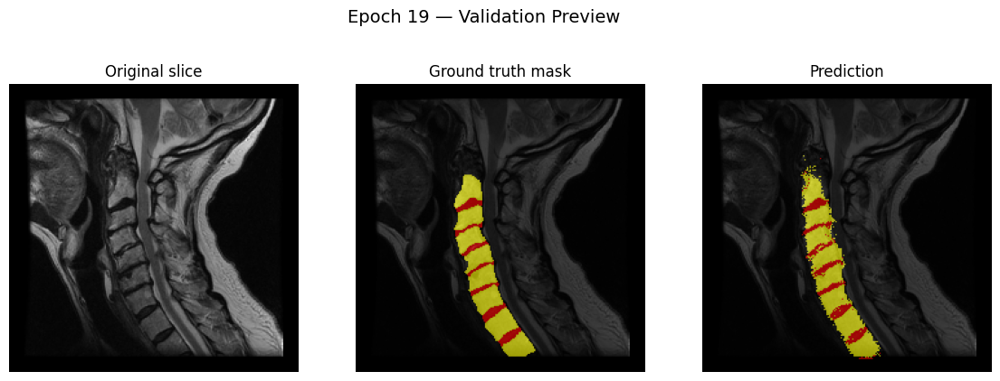

Epoch [19/20] Train Loss: 0.1146 Val Loss: 0.0474 Val Dice: 0.7670


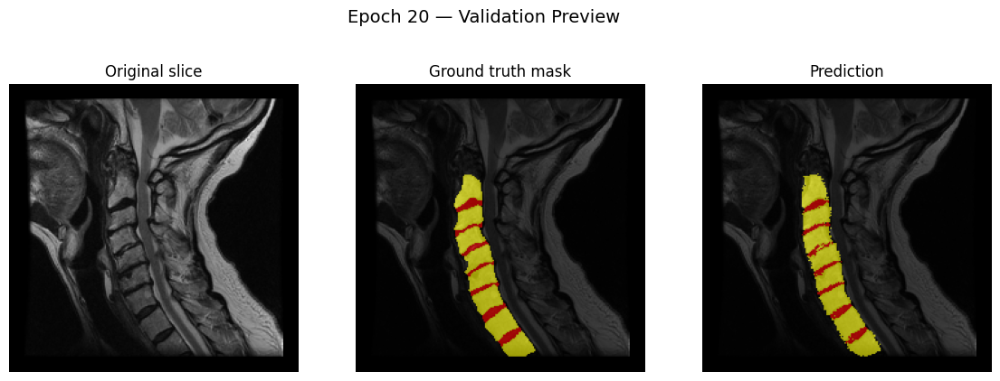

Epoch [20/20] Train Loss: 0.0842 Val Loss: 0.0435 Val Dice: 0.7839


In [13]:
# Here is the actual train/val loaders
train_loader = DataLoader(train_dataset, batch_size=2, shuffle=True,
                          num_workers=8, pin_memory=True, persistent_workers=True)
val_loader   = DataLoader(val_dataset,   batch_size=2, shuffle=False,
                          num_workers=4, pin_memory=True, persistent_workers=True)
test_loader  = DataLoader(test_dataset,  batch_size=2, shuffle=False,
                          num_workers=4, pin_memory=True, persistent_workers=True)

device = "cuda" if torch.cuda.is_available() else "cpu"
print(f"Initializing V-Net on {device}...")

model_vnet = model.VNetDeepSup(in_channels=1, out_channels=3, base_filters=16)

# Train
model_vnet, history = model.train_vnet_deep_sup(
    model_vnet, 
    train_loader, 
    val_loader, 
    device,
    save_name="VNet_Deep_Sup_v1.pth",
    num_epochs=20, 
    num_classes=3
)

In [14]:
# Save model weights
save_path = "../weights/VNet_Deep_Sup_v1/VNet_Deep_Supv1_all_epochs.pth"
torch.save(model_vnet.state_dict(), save_path)
print(f"Model saved to {save_path}")

Model saved to ../weights/VNet_Deep_Sup_v1/VNet_Deep_Supv1_all_epochs.pth


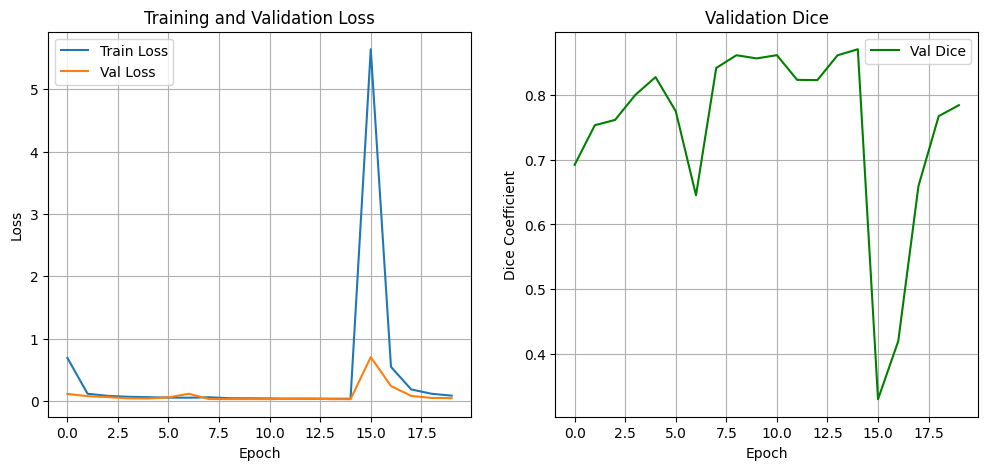

✔️ Saved training curves to ..\weights\VNet_Deep_Sup_v1\training_curves.png


In [15]:
# --- choose your folder ---
save_name = "VNet_Deep_Sup_v1"
save_dir = Path("../weights") / save_name
save_dir.mkdir(parents=True, exist_ok=True)

# Plot Training Curves
plt.figure(figsize=(12,5))

# Loss
plt.subplot(1,2,1)
plt.plot(history['train_loss'], label='Train Loss')
plt.plot(history['val_loss'], label='Val Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Training and Validation Loss')
plt.legend()
plt.grid(True)

# Dice
plt.subplot(1,2,2)
plt.plot(history['val_dice'], label='Val Dice', color='green')
plt.xlabel('Epoch')
plt.ylabel('Dice Coefficient')
plt.title('Validation Dice')
plt.legend()
plt.grid(True)

# Save
curve_path = save_dir / "training_curves.png"
plt.savefig(curve_path, dpi=200, bbox_inches="tight")

plt.show()

print(f"✔️ Saved training curves to {curve_path}")



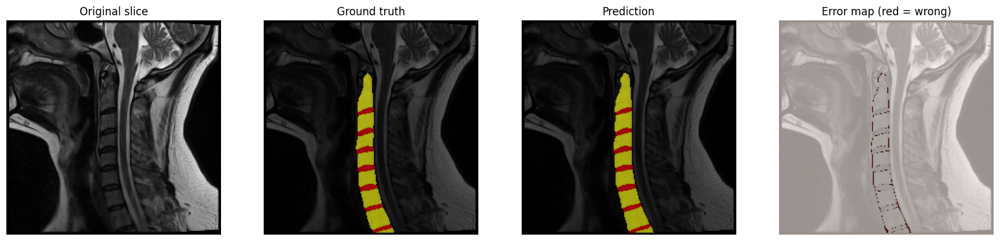

In [16]:
# Single-slice preview (Ground Truth vs Prediction vs Error)

model_UNet.load_state_dict(torch.load("../weights/UNet_0.1-1.0-1.0/UNet_0.1-1.0-1.0.pth"))
model_UNet.eval()

cmap = ListedColormap(["black", "yellow", "red"])  # background, class1 (vertebrae), class2 (disks)

# Get one test batch
vol, msk, patient_id = next(iter(test_loader))
vol = vol.to(device)

with torch.no_grad():
    logits = model_UNet(vol)
    probs = torch.softmax(logits, dim=1)
    pred_labels = torch.argmax(probs, dim=1)

pred_mask = pred_labels[0].cpu()
true_mask = msk[0]
image = vol[0,0].cpu()

# Pick a foreground slice
slices_with_fg = torch.where(true_mask.sum(dim=(0,1)) > 0)[0]
# print("Slices with foreground:", slices_with_fg[:20])
mid = int(slices_with_fg[len(slices_with_fg)//2])
# print("Using slice:", mid)

# Error map
error_map = (pred_mask[:,:,mid] != true_mask[:,:,mid]).float()

# Plot
plt.figure(figsize=(20,6))

# Original slice
plt.subplot(1,4,1)
plt.title("Original slice")
plt.imshow(image[:,:,mid], cmap="gray")
plt.axis("off")

# Ground truth
plt.subplot(1,4,2)
plt.title("Ground truth")
plt.imshow(image[:,:,mid], cmap="gray")
plt.imshow(true_mask[:,:,mid], cmap=cmap, alpha=0.6, vmin=0, vmax=2)
plt.axis("off")

# Prediction
plt.subplot(1,4,3)
plt.title("Prediction")
plt.imshow(image[:,:,mid], cmap="gray")
plt.imshow(pred_mask[:,:,mid], cmap=cmap, alpha=0.6, vmin=0, vmax=2)
plt.axis("off")

# Error
plt.subplot(1,4,4)
plt.title("Error map (red = wrong)")
plt.imshow(image[:,:,mid], cmap="gray")
plt.imshow(error_map, cmap="Reds", alpha=0.6)
plt.axis("off")

plt.show()


In [17]:
# Predicted vs True Class Frequencies
pred_unique, pred_counts = torch.unique(pred_labels.cpu(), return_counts=True)
true_unique, true_counts = torch.unique(true_mask.cpu(), return_counts=True)

print("PRED classes:", pred_unique, pred_counts)
print("TRUE classes:", true_unique, true_counts)

PRED classes: tensor([0, 1, 2]) tensor([4703864,   93892,   19140])
TRUE classes: tensor([0, 1, 2]) tensor([2365596,   34458,    8394])


The above matches up with what I said before, the minority class is being overpredicted.  
We can mess with the weights as well as dice warm-up a bit more before this model is perfect.

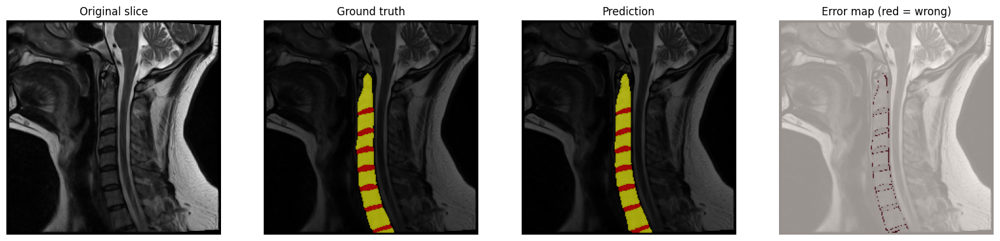

In [18]:
# Single-slice preview (Ground Truth vs Prediction vs Error)

model_vnet.load_state_dict(torch.load("../weights/VNet_Deep_Sup_v1/VNet_Deep_Sup_v1.pth"))
model_vnet.eval()

cmap = ListedColormap(["black", "yellow", "red"])  # background, class1 (vertebrae), class2 (disks)

# Get one test batch
vol, msk, patient_id = next(iter(test_loader))
vol = vol.to(device)

with torch.no_grad():
    logits = model_vnet(vol)
    probs = torch.softmax(logits, dim=1)
    pred_labels = torch.argmax(probs, dim=1)

pred_mask = pred_labels[0].cpu()
true_mask = msk[0]
image = vol[0,0].cpu()

# Pick a foreground slice
slices_with_fg = torch.where(true_mask.sum(dim=(0,1)) > 0)[0]
# print("Slices with foreground:", slices_with_fg[:20])
mid = int(slices_with_fg[len(slices_with_fg)//2])
# print("Using slice:", mid)

# Error map
error_map = (pred_mask[:,:,mid] != true_mask[:,:,mid]).float()

# Plot
plt.figure(figsize=(20,6))

# Original slice
plt.subplot(1,4,1)
plt.title("Original slice")
plt.imshow(image[:,:,mid], cmap="gray")
plt.axis("off")

# Ground truth
plt.subplot(1,4,2)
plt.title("Ground truth")
plt.imshow(image[:,:,mid], cmap="gray")
plt.imshow(true_mask[:,:,mid], cmap=cmap, alpha=0.6, vmin=0, vmax=2)
plt.axis("off")

# Prediction
plt.subplot(1,4,3)
plt.title("Prediction")
plt.imshow(image[:,:,mid], cmap="gray")
plt.imshow(pred_mask[:,:,mid], cmap=cmap, alpha=0.6, vmin=0, vmax=2)
plt.axis("off")

# Error
plt.subplot(1,4,4)
plt.title("Error map (red = wrong)")
plt.imshow(image[:,:,mid], cmap="gray")
plt.imshow(error_map, cmap="Reds", alpha=0.6)
plt.axis("off")

plt.show()


In [19]:
# Predicted vs True Class Frequencies
pred_unique, pred_counts = torch.unique(pred_labels.cpu(), return_counts=True)
true_unique, true_counts = torch.unique(true_mask.cpu(), return_counts=True)

print("PRED classes:", pred_unique, pred_counts)
print("TRUE classes:", true_unique, true_counts)

PRED classes: tensor([0, 1, 2]) tensor([4728226,   72514,   16156])
TRUE classes: tensor([0, 1, 2]) tensor([2365596,   34458,    8394])


Saved GIF: ../weights/UNet_0.1-1.0-1.0/UNet_0.1-1.0-1.0.gif


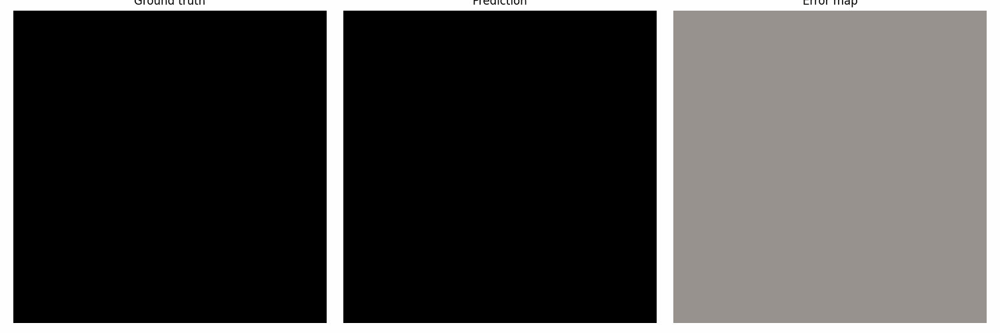

In [20]:
# Generate GIF: Ground Truth v Prediction vs Error (full volume)
import imageio
from io import BytesIO
from IPython.display import Image, display

model_UNet.load_state_dict(torch.load("../weights/UNet_0.1-1.0-1.0/UNet_0.1-1.0-1.0.pth"))
model_UNet.eval()

cmap = ListedColormap(["black", "yellow", "red"])

vol, msk, patient_id = next(iter(test_loader))
vol = vol.to(device)

with torch.no_grad():
    logits = model_UNet(vol)
    probs = torch.softmax(logits, dim=1)
    pred_labels = torch.argmax(probs, dim=1)

pred_mask = pred_labels[0].cpu()
true_mask = msk[0]
image = vol[0,0].cpu()

# Error map volume
error_map_vol = (pred_mask != true_mask).float()

frames = []

# Generate frames slice by slice
for s in range(image.shape[2]):
    fig, axes = plt.subplots(1, 3, figsize=(15,5))

    # Ground truth
    axes[0].imshow(image[:,:,s], cmap="gray")
    axes[0].imshow(true_mask[:,:,s], cmap=cmap, alpha=0.6, vmin=0, vmax=2)
    axes[0].set_title("Ground truth")
    axes[0].axis("off")

    # Prediction
    axes[1].imshow(image[:,:,s], cmap="gray")
    axes[1].imshow(pred_mask[:,:,s], cmap=cmap, alpha=0.6, vmin=0, vmax=2)
    axes[1].set_title("Prediction")
    axes[1].axis("off")

    # Error
    axes[2].imshow(image[:,:,s], cmap="gray")
    axes[2].imshow(error_map_vol[:,:,s], cmap="Reds", alpha=0.6)
    axes[2].set_title("Error map")
    axes[2].axis("off")

    plt.tight_layout()

    # Save current frame
    buf = BytesIO()
    plt.savefig(buf, format='png')
    plt.close(fig)
    buf.seek(0)
    frames.append(imageio.v2.imread(buf))

# Save GIF
gif_path = "../weights/UNet_0.1-1.0-1.0/UNet_0.1-1.0-1.0.gif"
imageio.mimsave(gif_path, frames, fps=5, loop=0)
print(f"Saved GIF: {gif_path}")

# Display inline
display(Image(filename=gif_path))


Saved GIF: ../weights/VNet_Deep_Sup_v1/VNet_Deep_Sup_v1.gif


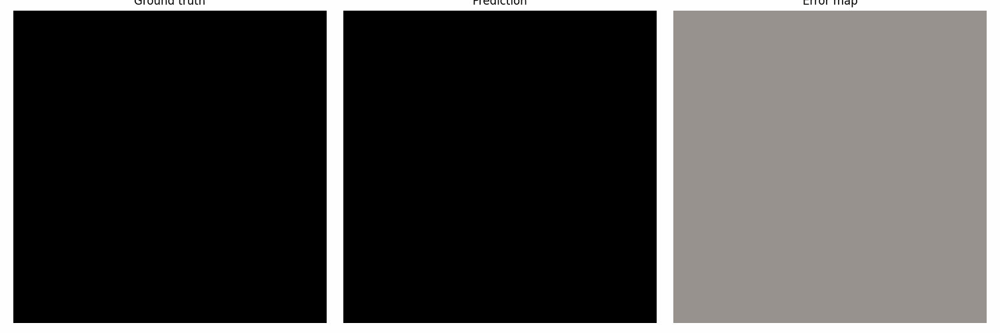

In [21]:
# Generate GIF: Ground Truth v Prediction vs Error (full volume)
import imageio
from io import BytesIO
from IPython.display import Image, display

model_vnet.load_state_dict(torch.load("../weights/VNet_Deep_Sup_v1/VNet_Deep_Sup_v1.pth"))
model_vnet.eval()

cmap = ListedColormap(["black", "yellow", "red"])

vol, msk, patient_id = next(iter(test_loader))
vol = vol.to(device)

with torch.no_grad():
    logits = model_vnet(vol)
    probs = torch.softmax(logits, dim=1)
    pred_labels = torch.argmax(probs, dim=1)

pred_mask = pred_labels[0].cpu()
true_mask = msk[0]
image = vol[0,0].cpu()

# Error map volume
error_map_vol = (pred_mask != true_mask).float()

frames = []

# Generate frames slice by slice
for s in range(image.shape[2]):
    fig, axes = plt.subplots(1, 3, figsize=(15,5))

    # Ground truth
    axes[0].imshow(image[:,:,s], cmap="gray")
    axes[0].imshow(true_mask[:,:,s], cmap=cmap, alpha=0.6, vmin=0, vmax=2)
    axes[0].set_title("Ground truth")
    axes[0].axis("off")

    # Prediction
    axes[1].imshow(image[:,:,s], cmap="gray")
    axes[1].imshow(pred_mask[:,:,s], cmap=cmap, alpha=0.6, vmin=0, vmax=2)
    axes[1].set_title("Prediction")
    axes[1].axis("off")

    # Error
    axes[2].imshow(image[:,:,s], cmap="gray")
    axes[2].imshow(error_map_vol[:,:,s], cmap="Reds", alpha=0.6)
    axes[2].set_title("Error map")
    axes[2].axis("off")

    plt.tight_layout()

    # Save current frame
    buf = BytesIO()
    plt.savefig(buf, format='png')
    plt.close(fig)
    buf.seek(0)
    frames.append(imageio.v2.imread(buf))

# Save GIF
gif_path = "../weights/VNet_Deep_Sup_v1/VNet_Deep_Sup_v1.gif"
imageio.mimsave(gif_path, frames, fps=5, loop=0)
print(f"Saved GIF: {gif_path}")

# Display inline
display(Image(filename=gif_path))
